# Spatio-Temporal Modeling with Convolutional Neural Networks

In this notebook, I will attempt to build a CNN model that will predict drought levels for all locations across the contiguous United States based on past data points. Each data point in the weekly time series consists of a rectangular grid where each point on the grid has an associated numerical value reflecting drought levels.

## Intitial Model
### X: 4 immediately preceding data points
### 5 epochs

In [1]:
import pandas as pd
import numpy as np
import datetime as dt
import matplotlib.pyplot as plt

np.random.seed(42)

from sklearn.model_selection import train_test_split
from keras.models import Sequential
from keras.layers import Dense, Dropout, Activation, Flatten
from keras.layers import Conv2D, MaxPooling2D, Conv3D, MaxPooling3D
from keras.utils import np_utils

%matplotlib inline

Using TensorFlow backend.


In [2]:
drought_array = pd.read_csv("./data/drought_simplified_array.csv")

In [3]:
drought_array.drop(columns="Unnamed: 0", inplace=True)

In [4]:
drt = pd.read_csv("./data/drought_data_combined.csv")

drt.set_index("Date", inplace=True)

drt.index = pd.to_datetime(drt.index)

In [5]:
latitudes = [0.25*i for i in list(range(96, 201))]
latitudes.reverse()

longitudes = [0.25*i for i in list(range(-500, -263))]

dates = list(drt.index.unique().sort_values())

In [6]:
drought_3D = drought_array.values.reshape(len(dates), len(latitudes), len(longitudes))

In [7]:
drought_3D.shape

(1009, 105, 237)

In [8]:
drought_3D[4:].shape

(1005, 105, 237)

In [9]:
drought_3D[:-4].shape

(1005, 105, 237)

Initially, I'll try a model in which the X variable is the previous 4 data points in the time series.

In [10]:
# lag = 4 weeks
X = np.array([])
for i in range(drought_3D[:-4].shape[0]):
    data_point = np.array([drought_3D[i], drought_3D[i+1], drought_3D[i+2], drought_3D[i+3]])
    X = np.append(X, data_point)

In [11]:
X.shape

(100037700,)

In [12]:
X_matrix = X.reshape(1005, 4, 105, 237, 1)

In [13]:
X_matrix.shape

(1005, 4, 105, 237, 1)

In [14]:
105*237

24885

In order for the CNN to generate predictions, the output layer needs to be one dimensional. I will reshape the time series data such that each point in the time series is a one-dimensional vector as opposed to a 2-dimensional grid. Once I generate predictions, I will reshape those predictions back to the map form.

In [15]:
Y = drought_3D[4:].reshape(1005, 24_885)

In [16]:
Y.shape

(1005, 24885)

In [17]:
X_train = X_matrix[:725]
X_test  = X_matrix[725:]
Y_train = Y[:725]
Y_test  = Y[725:]

In [18]:
X_train.shape

(725, 4, 105, 237, 1)

In [19]:
X_test.shape

(280, 4, 105, 237, 1)

In [20]:
Y_train.shape

(725, 24885)

In [21]:
Y_test.shape

(280, 24885)

In [22]:
np.array(pd.DataFrame(Y_test).loc[:, 0]).shape

(280,)

In [23]:
len(Y_test[0])

24885

I found the function below from the following stack overflow page: https://stackoverflow.com/questions/45250100/kerasregressor-coefficient-of-determination-r2-score

It needs to be modified so that it cycles through the time series for each pixel out of the 24,885. I will work on correcting this moving forward. I have not been able to figure this out, so as it is now, the r2 scores that are displayed are erroneous. I'm not sure what they represent. The MSE and MAE metrics should be correct.

In [ ]:
# def r2_score(y_true, y_pred):
#     from keras import backend as K
#     SS_res =  K.sum(K.square( y_true-y_pred ))
#     SS_tot = K.sum(K.square( y_true - K.mean(y_true) ) )
#     return ( 1 - SS_res/(SS_tot + K.epsilon()) )

In [24]:
Y_test.shape

(280, 24885)

### CNN Model

In [25]:
cnn_model = Sequential()

In [26]:
cnn_model.add(Conv3D(filters = 6,                # number of filters
                     kernel_size = (2, 9, 9),    # height/width of filter, could increase the 5,5
                     activation='relu',          # activation function 
                     input_shape=(4,105,237,1))) # shape of input

In [27]:
cnn_model.add(MaxPooling3D(pool_size=(1,4,4))) # dimensions of region of pooling

In [28]:
cnn_model.add(Conv3D(16,
                     kernel_size=(2, 9, 9),
                     activation='relu'))

In [29]:
cnn_model.add(MaxPooling3D(pool_size=(1,4,4)))

In [30]:
cnn_model.add(Flatten())

In [31]:
cnn_model.add(Dense(128, activation='relu'))

In [32]:
cnn_model.add(Dense(24_885, activation='linear'))

In [33]:
cnn_model.compile(loss='mean_squared_error',
                  optimizer='adam',
                  metrics=['mse', "mae"])

In [34]:
history = cnn_model.fit(X_train,
                        Y_train,
                        batch_size=256,
                        validation_data=(X_test, Y_test),
                        epochs=5,
                        verbose=1)

Train on 725 samples, validate on 280 samples
Epoch 1/5
725/725 [==============================] - 215s 297ms/step - loss: 2.4183 - mean_squared_error: 2.4183 - mean_absolute_error: 0.7216 - val_loss: 1.5643 - val_mean_squared_error: 1.5643 - val_mean_absolute_error: 0.5517
Epoch 2/5
725/725 [==============================] - 209s 288ms/step - loss: 1.7512 - mean_squared_error: 1.7512 - mean_absolute_error: 0.7325 - val_loss: 1.1754 - val_mean_squared_error: 1.1754 - val_mean_absolute_error: 0.6706
Epoch 3/5
725/725 [==============================] - 209s 288ms/step - loss: 1.1739 - mean_squared_error: 1.1739 - mean_absolute_error: 0.6586 - val_loss: 1.0941 - val_mean_squared_error: 1.0941 - val_mean_absolute_error: 0.5393
Epoch 4/5
725/725 [==============================] - 214s 295ms/step - loss: 1.0779 - mean_squared_error: 1.0779 - mean_absolute_error: 0.5864 - val_loss: 1.2362 - val_mean_squared_error: 1.2362 - val_mean_absolute_error: 0.5982
Epoch 5/5
725/725 [===================

In [35]:
cnn_model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv3d_1 (Conv3D)            (None, 3, 97, 229, 6)     978       
_________________________________________________________________
max_pooling3d_1 (MaxPooling3 (None, 3, 24, 57, 6)      0         
_________________________________________________________________
conv3d_2 (Conv3D)            (None, 2, 16, 49, 16)     15568     
_________________________________________________________________
max_pooling3d_2 (MaxPooling3 (None, 2, 4, 12, 16)      0         
_________________________________________________________________
flatten_1 (Flatten)          (None, 1536)              0         
_________________________________________________________________
dense_1 (Dense)              (None, 128)               196736    
_________________________________________________________________
dense_2 (Dense)              (None, 24885)             3210165   
Total para

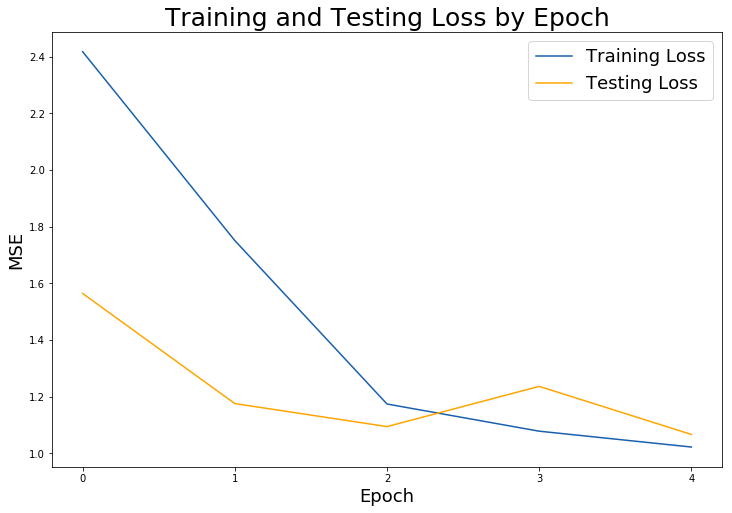

In [36]:
# Check out our train loss and test loss over epochs.
train_loss = history.history['loss']
test_loss = history.history['val_loss']

# Set figure size.
plt.figure(figsize=(12, 8))

# Generate line plot of training, testing loss over epochs.
plt.plot(train_loss, label='Training Loss', color='#185fad')
plt.plot(test_loss, label='Testing Loss', color='orange')

# Set title
plt.title('Training and Testing Loss by Epoch', fontsize = 25)
plt.xlabel('Epoch', fontsize = 18)
plt.ylabel('MSE', fontsize = 18)
plt.xticks([0, 1, 2, 3, 4])

plt.legend(fontsize = 18);


In [37]:
# Evaluate model on test data.
cnn_score = cnn_model.evaluate(X_test,
                               Y_test,
                               verbose=1)

cnn_labels = cnn_model.metrics_names

# Compare models.

print(f'CNN 1 {cnn_labels[1]}  : {cnn_score[1]}')
print(f'CNN 1 {cnn_labels[2]}   : {cnn_score[2]}')

print()

cnn_model.summary()

280/280 [==============================] - 12s 42ms/step
CNN 1 mean_squared_error  : 1.0664251003946577
CNN 1 mean_absolute_error   : 0.5266554977212633

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv3d_1 (Conv3D)            (None, 3, 97, 229, 6)     978       
_________________________________________________________________
max_pooling3d_1 (MaxPooling3 (None, 3, 24, 57, 6)      0         
_________________________________________________________________
conv3d_2 (Conv3D)            (None, 2, 16, 49, 16)     15568     
_________________________________________________________________
max_pooling3d_2 (MaxPooling3 (None, 2, 4, 12, 16)      0         
_________________________________________________________________
flatten_1 (Flatten)          (None, 1536)              0         
_________________________________________________________________
dense_1 (Dense)              (None, 128)              

In [38]:
predictions = cnn_model.predict(X_test)

In [39]:
predictions.shape

(280, 24885)

In [40]:
prediction_3D = predictions.reshape(280, 105, 237)

In [41]:
Y_test = Y_test.reshape(280, 105, 237)

In [42]:
Y_train = Y_train.reshape(725, 105, 237)

Animation size has reached 21029267 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


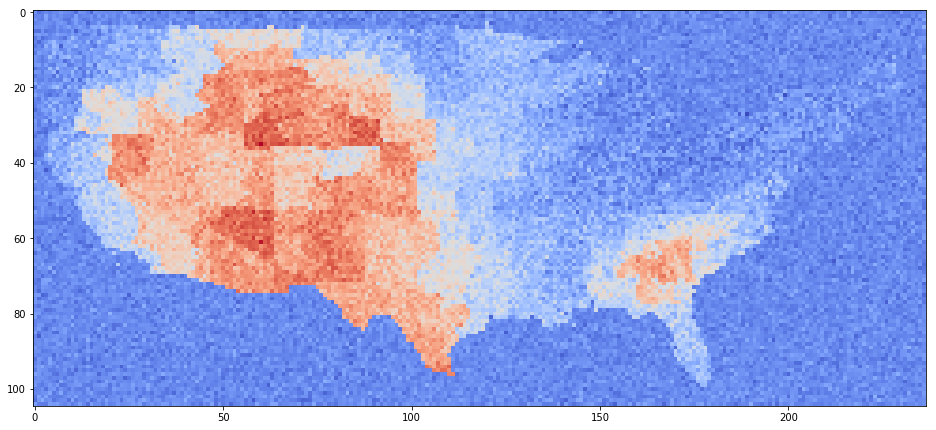

In [43]:
import matplotlib.animation as animation
from IPython.display import HTML

fig = plt.figure(figsize=(16, 12))

prediction_images = []
for i in range(len(prediction_3D)):
    prediction_image = plt.imshow(prediction_3D[i], animated=True, cmap="coolwarm")
    prediction_images.append([prediction_image])

ani = animation.ArtistAnimation(fig, prediction_images, interval=50, blit=True,
                            repeat_delay=1000)


from IPython.display import HTML
HTML(ani.to_jshtml())

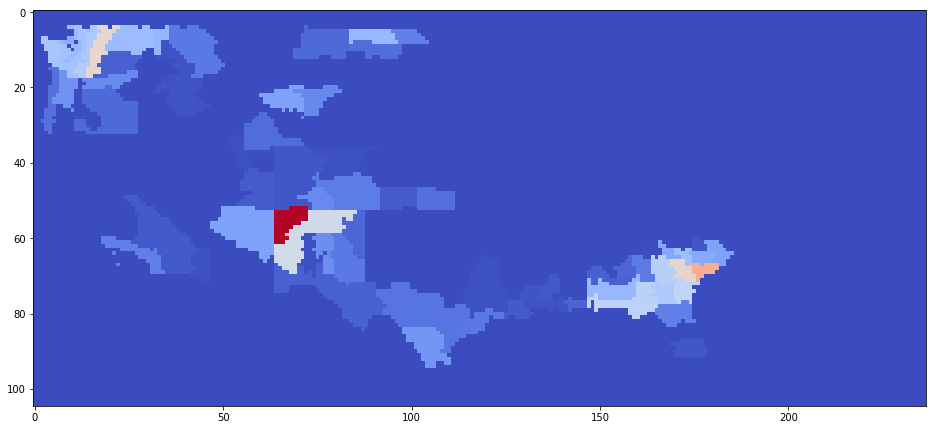

In [44]:
fig = plt.figure(figsize=(16, 12))

testing_images = []
for i in range(len(Y_test)):
    testing_image = plt.imshow(Y_test[i], animated=True, cmap="coolwarm")
    testing_images.append([testing_image])

ani = animation.ArtistAnimation(fig, testing_images, interval=50, blit=True,
                                repeat_delay=1000)

# ani.save("./images/drought_data_timelapse.mp4")

from IPython.display import HTML
HTML(ani.to_jshtml())

The initial predictions hardly fluctuate at all over time. I will try adding epochs and modifying the X variables in order to generate a behavior that more accurately reflects that actual data.